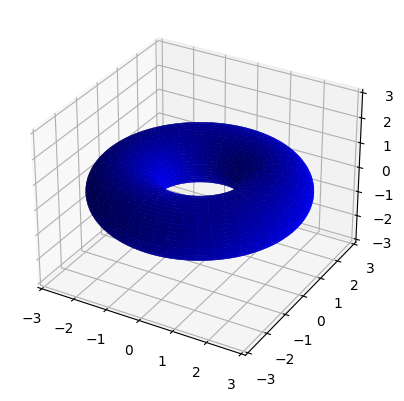

In [1]:
import numpy as np


import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Parameters
A = 1.0  # Amplitude
B = 1.0  # Frequency
R1 = 1.0  # Radius of the circle
R2 = 2.0  # Radius of the torus

# Create figure and axis
fig, ax = plt.subplots(subplot_kw={'projection': '3d'})
ax.set_xlim([-3, 3])
ax.set_ylim([-3, 3])
ax.set_zlim([-3, 3])

# Function to update the plot
def update(num, data, line):
    ax.clear()
    ax.set_xlim([-3, 3])
    ax.set_ylim([-3, 3])
    ax.set_zlim([-3, 3])
    ax.plot_surface(data[0], data[1], data[2], color='b')
    return line,

# Generate the data for the donut
theta = np.linspace(0, 2 * np.pi, 100)
phi = np.linspace(0, 2 * np.pi, 100)
theta, phi = np.meshgrid(theta, phi)
X = (R2 + R1 * np.cos(theta)) * np.cos(phi)
Y = (R2 + R1 * np.cos(theta)) * np.sin(phi)
Z = R1 * np.sin(theta)

data = [X, Y, Z]

# Create the animation
line = [ax.plot_surface(X, Y, Z, color='b')]
ani = animation.FuncAnimation(fig, update, frames=100, fargs=(data, line), interval=50, blit=False)

plt.show()

C:\Users\norbe\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\matplotlib\animation.py:884: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(
Animation size has reached 21146161 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


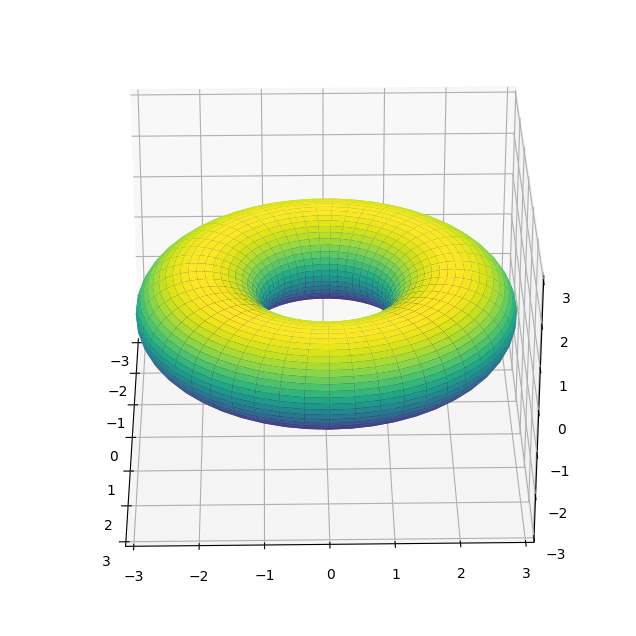

In [2]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Set up the figure and 3D axis
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection='3d')

# Generate the torus mesh
theta = np.linspace(0, 2 * np.pi, 50)
phi = np.linspace(0, 2 * np.pi, 50)
theta, phi = np.meshgrid(theta, phi)

# Torus parameters
R = 2  # Major radius
r = 1  # Minor radius

# Parametric equations for the torus
X = (R + r * np.cos(phi)) * np.cos(theta)
Y = (R + r * np.cos(phi)) * np.sin(theta)
Z = r * np.sin(phi)

# Initial plot
surf = ax.plot_surface(X, Y, Z, cmap='viridis')

# Set axis limits
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.set_zlim(-3, 3)

# Animation function
def animate(i):
    ax.view_init(elev=30, azim=i)
    return surf,

# Create animation
ani = FuncAnimation(fig, animate, frames=360, interval=20, blit=False)

# Display the animation in the notebook
HTML(ani.to_jshtml())


In [6]:
import numpy as np
import time
from IPython.display import clear_output

# Define screen size
width = 40
height = 24

# ASCII characters used for shading (from darkest to brightest)
shades = ".,-~:;=!*#$@"

# Animation loop
for frame in range(0, 360, 2):
    # Create a 2D array to represent the screen
    screen = np.full((height, width), ' ')
    
    # Precompute angles
    A = np.deg2rad(frame)
    B = np.deg2rad(frame / 2)
    sin_A = np.sin(A)
    cos_A = np.cos(A)
    sin_B = np.sin(B)
    cos_B = np.cos(B)
    
    # Torus parameters
    R1 = 1  # Major radius
    R2 = 2  # Minor radius
    
    for theta in np.linspace(0, 2 * np.pi, 90):
        for phi in np.linspace(0, 2 * np.pi, 90):
            sin_theta = np.sin(theta)
            cos_theta = np.cos(theta)
            sin_phi = np.sin(phi)
            cos_phi = np.cos(phi)
            
            # Calculate 3D coordinates
            circle_x = R2 + R1 * cos_theta
            circle_y = R1 * sin_theta
            
            # 3D rotation
            x = circle_x * (cos_B * cos_phi + sin_A * sin_B * sin_phi) - circle_y * cos_A * sin_B
            y = circle_x * (sin_B * cos_phi - sin_A * cos_B * sin_phi) + circle_y * cos_A * cos_B
            z = circle_x * (cos_A * sin_phi) + circle_y * sin_A
            ooz = 1 / (z + 5)  # Offset to prevent division by zero
            
            # Projection onto 2D screen
            xp = int(width / 2 + x * ooz * width / 2)
            yp = int(height / 2 - y * ooz * height / 2)
            
            # Calculate luminance (normalize to [0, len(shades) - 1])
            L = cos_phi * cos_theta * sin_B - cos_A * cos_theta * sin_phi - sin_A * sin_theta + cos_B * (cos_A * sin_theta - sin_A * cos_theta * sin_phi)
            luminance_index = int((L + 1) / 2 * (len(shades) - 1))
            luminance_index = max(0, min(len(shades) - 1, luminance_index))  # Ensure index is within bounds
            
            if 0 <= xp < width and 0 <= yp < height:
                if ooz > 0:
                    screen[yp, xp] = shades[luminance_index]
    
    # Clear the output and print the screen
    clear_output(wait=True)
    print('\n'.join(''.join(row) for row in screen))
    time.sleep(0.03)


                                        
                                        
                                        
                                        
                                        
                                        
                                        
           @@@@@@@@@@@@@@@@@            
       @@@@@@@@@@@#@#@$@@@@@@@@@        
      @@@@@#@@@@!@=@=@!@*@@@@@@@@@      
     $$@@@@@=@;@;@;@;@;@=@=@@@@@@@$     
     !=;;:$$-@,@.@.@.@.@,@-$~$$$$$#     
     ;:~--,--,,..........,,--~:;==!     
     ;~-,.....,~..............,-~:=     
      :-,.....................,-~:      
         ,....................,-        
                                        
                                        
                                        
                                        
                                        
                                        
                                        
                                        
